In [ ]:
# Import necessary libraries
import os, re, time, urllib.parse, urllib.request, gzip, json, math, requests, csv, statistics
from collections import defaultdict, Counter

import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import networkx as nx
import seaborn as sns

from scipy.stats import pearsonr
from adjustText import adjust_text
from networkx.readwrite import json_graph
from networkx.algorithms.community import louvain_communities
from networkx.algorithms.community.quality import modularity


### Spotify API to add Genre to a Artist and Festival (scarping og festival and artist already happend)

The strategy was to first do a spotify api work and then do some manual adjustments for areas known to not have either spotify or other api, such as "orkester". Then for all artist without a genre, a classic wiki search is made, scarping wiki pages for either the "genre" or "genres" field. Lastly a clean is made for slip ups in request if wiki pages, ensure a streamlined genre category.

In [56]:
# ==========  BUILD BIPARTITE GRAPH ==========

# Load data
url = "https://raw.githubusercontent.com/MittaHage/danish-music-festival-ecosystem/main/festival_artist_data.csv"

df = pd.read_csv(url)

#count rows in df
print("Number of rows in dataframe:", len(df))

G = nx.Graph()

# Add nodes and edges
for _, row in df.iterrows():
    festival_node = row['Festival_Year']
    artist_node = row['Artist_Name']
        # --- Extract festival name + year ---

    parts = festival_node.split("-")

    festival_name = parts[0]          # always first element
    year_str = parts[-1]              # always last element

    # --- Add festival-year node with attributes ---
    G.add_node(
        festival_node,
        bipartite="festival_year",
        festival=festival_name,
        year=year_str    
        )

    G.add_node(artist_node, bipartite="artist")

    G.add_edge(festival_node, artist_node)

Number of rows in dataframe: 13131


In [57]:
#split the nodes into artist and festival nodes
artist_nodes = [n for n, d in G.nodes(data=True) if d.get('bipartite') == 'artist']
festival_nodes = [n for n, d in G.nodes(data=True) if d.get('bipartite') == 'festival_year']

print("Number of artist nodes:", len(artist_nodes))
print("Number of festival-year nodes:", len(festival_nodes))    

Number of artist nodes: 7340
Number of festival-year nodes: 316


In [ ]:
import requests
import networkx as nx

# "Client" ID for dashboard in Spotify

CLIENT_ID = "7cddd134430f4b0ab6b9d4aaf73fd3f6"
CLIENT_SECRET = "7d78b6bcb8bd4e7c9794da6f415ed703"

# Get access token via Client Credentials Flow
def get_access_token(client_id, client_secret):
    url = "https://accounts.spotify.com/api/token"
    data = {
        "grant_type": "client_credentials",
        "client_id": client_id,
        "client_secret": client_secret,
    }
    resp = requests.post(url, data=data)
    resp.raise_for_status()
    return resp.json()["access_token"]

access_token = get_access_token(CLIENT_ID, CLIENT_SECRET)
headers = {"Authorization": f"Bearer {access_token}"}
TOKEN_TIME = time.time()   # <-- nrecords when access token loast was updated, as it "runs out" after an hour


#normalize artis name from csv file, helper to match with spotify data
def normalize_artist_name(name):
    return name.replace("-", " ")


#refresh token when it expires
def refresh_token_if_needed():
    global access_token, headers, TOKEN_TIME
    # 1800 seconds = 30 minutes
    if time.time() - TOKEN_TIME > 1800:
        print("Refreshing token (30-minute rule)...")
        access_token = get_access_token(CLIENT_ID, CLIENT_SECRET)
        headers["Authorization"] = f"Bearer {access_token}"
        TOKEN_TIME = time.time()



# non batch search (sadly) for the artist id 
def search_artist_id(name, headers):
    refresh_token_if_needed()   # <-- added to ensure token is not expired

    url = "https://api.spotify.com/v1/search"
    params = {"q": name, "type": "artist", "limit": 1}

    r = requests.get(url, headers=headers, params=params)
    data = r.json()

    # If token still expired, retry once, double check
    if "error" in data and data["error"]["status"] == 401:
        print("Token expired — refreshing...")
        refresh_token_if_needed()
        r = requests.get(url, headers=headers, params=params)
        data = r.json()

    items = data.get("artists", {}).get("items", [])
    if not items:
        return None
    return items[0]["id"]

# the artist id did not have batch searched, but the request for data related to artist does have the ability of doing batch search 
#this chucks artist to do batch search
def chunk_list(lst, size):
    for i in range(0, len(lst), size):
        yield lst[i:i + size]

#batch request to spotify for artist information
def fetch_artists_batch(ids, headers):
    url = "https://api.spotify.com/v1/artists"
    params = {"ids": ",".join(ids)}
    r = requests.get(url, headers=headers, params=params).json()
    return r.get("artists", [])

In [ ]:
#match artist names to spotify artist id's
artist_to_id = {}
total = len(artist_nodes)

for i, artist in enumerate(artist_nodes, start=1):
    clean_name = normalize_artist_name(artist)
    
    artist_id = search_artist_id(clean_name, headers)
    artist_to_id[artist] = artist_id
    
    # progress every 50 artists
    if i % 50 == 0 or i == total:
        print(f"Fetched IDs for {i}/{total} artists")
        print(artist_to_id)


#filter on invalid ids and create batches of 50 ids for batch search of relevant information
valid_items = [(name, artist_to_id[name]) for name in artist_nodes if artist_to_id[name]]
batches = list(chunk_list(valid_items, 50))


#batch search and looking for the popularity and genres element
total_batches = len(batches)
processed = 0
print("Starting to load artist attributes in batches...")
for batch in batches:
    # Extract only the IDs
    id_list = [item[1] for item in batch]

    # Fetch info for 50 artists at once
    results = fetch_artists_batch(id_list, headers)

    # Walk both lists together
    for (artist_name, artist_id), data in zip(batch, results):
        genres = [g.lower() for g in data.get("genres", [])]
        popularity = data.get("popularity", None)

        G.nodes[artist_name]["genres"] = genres
        G.nodes[artist_name]["popularity"] = popularity

    processed += 1
    print(f"Loaded batch {processed}/{total_batches}")


Fetched IDs for 50/7106 artists
{'surprise': '2Ks1Z1scmEDZfaYaCS7Osj', 'tom-bailey': '6nUOrgkHVLMY7Zoe3IXQhJ', 'gasolin': '0e7UgnX6ObqqX5EcMeuA0E', 'vannis-aften': '4ZwOlDVAGXQo66ykbLQ8dP', 'sunny-side-stompers': '2M8siACtKsHdqRo2y5YE1Z', 'dr-dopojam': '7fATs71dWrJ2nKQthYVL9I', 'per-kofoed': '2ZQifdPOptKHxTaYTLh0BC', 'phillias-fogg': '1xDMmkAW6DrADuWgScQ8ON', 'midnight-sun': '1Xylc3o4UrD53lo9CvFvVg', 'strawbs': '7dtYyLTWjuZGOcweC3eD2f', 'papa-bues-jazzband': '462IZGRdyi5i2yThvgmzIB', 'povl-dissing': '0qpWZe4Tl9yLoMSKdIREIT', 'stefan-grossman': '0me2CHAdEKm5MTWHemzRk5', 'stefan-grossmand': '0me2CHAdEKm5MTWHemzRk5', 'sebastian-band': '7FsRH5bw8iWpSbMX1G7xf1', 'andrew-john': '7JZLd5Z6BNaOXEap8Rl8YL', 'c-sar': '2d6fU7pGHJDtMXbcX2fpvr', 'burnin-red-ivanhoe': '1wenrzNQvucvSMKk939Uwe', 'alex-campbell': '6CRBzATQbbbzm0aYwlqtwC', 'spider-john-koerner': '7CA7FJBftyM0hSJaF6GWqT', 'lousiana-hot-seven': '2M8siACtKsHdqRo2y5YE1Z', 'fessors-big-city-band': '35JBPBopvwGhzUyJapFKpl', 'per-dich': '2y4OvO

In [ ]:
# ensure all "orkester" artists have "orchestral" genre assigned. Most of them did not have spotify, so needed manual adjustment
orkester_artists = [n for n in G.nodes if "orkester" in n.lower()]

for a in orkester_artists:
    genres = G.nodes[a].get("genres", [])

    # make sure we’re working with a list
    if genres is None:
        genres = []

    # add "orchestral" only if it's missing
    if "orchestral" not in [g.lower() for g in genres]:
        genres.append("orchestral")

    G.nodes[a]["genres"] = genres

In [66]:
#count how mant artists have genres assigned and how many are missing
with_genres = sum(1 for artist in artist_nodes if G.nodes[artist].get("genres"))
without_genres = len(artist_nodes) - with_genres 
print(f"Artists with genres: {with_genres}, without genres: {without_genres}")

Artists with genres: 5905, without genres: 1201


In [67]:
#count how mant artists have popularity assigned and how many are missing
with_genres = sum(1 for artist in artist_nodes if G.nodes[artist].get("popularity"))
without_genres = len(artist_nodes) - with_genres 
print(f"Artists with popularity: {with_genres}, without popularity: {without_genres}")

Artists with popularity: 6682, without popularity: 424


In [ ]:
#wikipida search for genres
#we will first search in english wiki pages, and if no results then turn to danish.
def _get_genres_from_specific_wiki(title, lang):
    url = f"https://{lang}.wikipedia.org/w/api.php"
    params = {
        "action": "parse",
        "page": title,
        "prop": "text",
        "format": "json"
    }

    headers = {"User-Agent": "student-project/1.0"}

    r = requests.get(url, params=params, headers=headers, timeout=20)
    if r.status_code != 200:
        return []

    try:
        html = r.json()["parse"]["text"]["*"]
    except:
        return []

    # Get entire infobox
    infobox = re.search(r'<table class="infobox([^>]*)>(.*?)</table>', html, re.DOTALL)
    if not infobox:
        return []

    infobox_html = infobox.group(0)

    # Match Genre(s) row in English AND Danish (Genre, Genres, Genre(r))
    match = re.search(
        r'<th[^>]*>\s*(?:Genre|Genres|Genreer|Genrer)\s*</th>.*?<td[^>]*>(.*?)</td>',
        infobox_html,
        flags=re.DOTALL | re.IGNORECASE
    )

    if not match:
        return []

    td_html = match.group(1)

    # extract both linked and plain list items
    linked = re.findall(r'<a[^>]*>(.*?)</a>', td_html, re.DOTALL)
    list_items = re.findall(r'<li[^>]*>(.*?)</li>', td_html, re.DOTALL)

    raw_items = linked + list_items

    cleaned = []
    for item in raw_items:
        t = item.strip().lower()

        # remove all HTML tags
        t = re.sub(r'<[^>]+>', '', t).strip()

        # decode HTML entities like &#91;1&#93; -> [1]
        #t = html.unescape(t)

        # remove bracketed citation junk like [1], [12], [a], etc.
        t = re.sub(r"\[\s*[\w\d]+\s*\]", "", t)

        # ignore leftover junk
        if "cite-bracket" in t:
            continue
        if re.fullmatch(r'\d+', t):
            continue
        if not re.search(r'[a-zæøå]', t):  # allow Danish letters
            continue

        t = t.replace("·", " ").strip()

        if t:
            cleaned.append(t)

    return sorted(set(cleaned))

#def running, firstly matching english if no genres match then danish
def get_genres_from_wikipedia(title):
    # Try English Wikipedia first, then Danish Wikipedia
    for lang in ["en", "da"]:
        genres = _get_genres_from_specific_wiki(title, lang)
        if genres:
            return genres
    return []

# we are checking different kind of page names, with different suflixs.
def find_genres_for_artist(artist, G):
    clean_name = artist.replace("-", " ")

    # 1. raw name
    attempts = [clean_name]

    # 2. "(band)"
    attempts.append(f"{clean_name} (band)")

    # 3. capitalized version
    cap = clean_name.title()
    attempts.append(cap)

    # 4–6. singer / rapper / DJ
    attempts.append(f"{cap} (singer)")
    attempts.append(f"{cap} (rapper)")
    attempts.append(f"{cap} (DJ)")
    attempts.append(f"{cap} (Danish band)")
    attempts.append(f"{cap} (band)")
    #print(attempts)
    # try each possibility until something works
    for title in attempts:
        genres = get_genres_from_wikipedia(title)
        if genres:
            print(genres)
            break

    # store result if found
    if genres:
        #print("found it for", artist, "as", title)
        G.nodes[artist]["genres"] = genres

    return genres



In [ ]:
#looping over all artist without a genre and adding if found.

wiki_counter = 0
for artist in artist_nodes:
    if not G.nodes[artist].get("genres"):
        genres=find_genres_for_artist(artist, G)
        G.nodes[artist]["genres"] = genres
        #print(f"Assigned genres for {artist}: {genres}")
        wiki_counter += 1

['pop', 'r&amp;b', 'r&amp;b&#91;2&#93;', 'soul']
['alternative rock', 'indie pop']
['alternative rock', 'emo pop', 'indie rock', 'power pop']
['alternative rock', 'alternative rock&#91;1&#93;', 'post-britpop', 'post-britpop&#91;4&#93;&#91;5&#93;', 'rock', 'rock&#91;2&#93;&#91;3&#93;', 'soft rock', 'soft rock&#91;5&#93;']
['folk-pop', 'indie pop']
['art pop', 'art rock', 'electronica', 'experimental pop', 'indie rock', 'progressive rock']
['baroque pop', 'baroque pop&#91;4&#93;', 'indie pop', 'indie pop&#91;1&#93;', 'indie rock', 'indie rock&#91;2&#93;', 'pop rock', 'pop rock&#91;3&#93;']
['alternative r&amp;b', 'electronica', 'indie pop', 'trip hop']
['alternative rock', 'indie rock']
['chamber pop', 'indie pop']
['alternative r&amp;b', 'avant-soul', 'hip-hop', 'psychedelic soul']
['alternative rock', 'alternative rock&#91;1&#93;', 'indie rock', 'indie rock&#91;4&#93;', 'post-britpop', 'post-britpop&#91;3&#93;', 'power pop', 'power pop&#91;2&#93;']
['indie pop', 'r&amp;b']
['emo', 'emo

In [ ]:
#print all arstists without a genre assigned and have more than 2 festival appearances
#we have set a goal to get genres for all artist having a degree higher than 2
for artist in artist_nodes:
    if not G.nodes[artist].get("genres"):
        degree = G.degree(artist)
        if degree > 2:
            print(f"{artist} - Festivals: {degree}")

To ensure we reach to goal of getting genres for all artist having a higher degree than 2, then as a last resource we went for a LLM to help. 

We gave the following prompt to ensure that it had support behind the choice of genres:

"

I have a list of artist names and the number of festivals they played at. For each artist, I want you to return a Python assignment of the form:

G.nodes["artist-name"]["genres"] = ["genre1", "genre2", ...]

**Rules:**
- All genres must be in lowercase.

- Use real, correct genres based on the artist’s actual music.

- The output must contain only Python code, one line per artist.

- Do not add comments, explanations, or extra text unless I explicitly ask for it.

Here is the list of artists:
[insert artist list here]

"

In [64]:
#LLM and manual assignment for remaining missing genres

G.nodes["superscum"]["genres"] =["rock","folk-rock"] 

G.nodes["michael-learns-to-rock"]["genres"] =["soft rock","pop rock"] 
G.nodes["peter-de-andre-kopier"]["genres"] =["pop","rock"] 
G.nodes["queen-machine"]["genres"] =["rock"] 
G.nodes["kaleo"]["genres"] =["blues rock", "indie folk", "alternative rock"] 

G.nodes["the-powls"]["genres"] =["pop", "dansktop", "party music", "light rock"] 
G.nodes["nothing-but-thieves"]["genres"] =["alternative rock", "indie rock", "hard rock"] 
G.nodes["led-zeppelin-jam"]["genres"] =["rock"] 
G.nodes["die-herren"]["genres"] =["alternativ rock", "post punk", "rock"] 
G.nodes["nick-cave-the-bad-seeds"]["genres"] =["alternativ rock", "gothic rock", "experimental rock", "art rock", "post punk"] 
G.nodes["fielfraz"]["genres"] =["rock"] 
G.nodes["kaare-norge"]["genres"] =["classic music"] 
G.nodes["kongsted"]["genres"] =["dj"] 
G.nodes["teitur"]["genres"] =["classic music"] 

G.nodes["choir-of-young-believers"]["genres"] = [
    "indie pop",
    "indie rock",
    "art pop",
    "dream pop",
    "chamber pop"
]
G.nodes["midnight-sun"]["genres"] = ["hard rock", "heavy metal"]
G.nodes["andrew-john"]["genres"] = ["folk", "singer-songwriter"]
G.nodes["alex-campbell"]["genres"] = ["folk", "scottish folk"]
G.nodes["fujara"]["genres"] = ["world", "slovak folk", "traditional"]
G.nodes["r-de-mor"]["genres"] = ["danish rock"]  # extremely obscure, best match
G.nodes["spillem-ndene"]["genres"] = ["danish folk"]  # local traditional band
G.nodes["buki-yamaz"]["genres"] = ["experimental", "avant-garde"]  # rare act
G.nodes["mike-whellans"]["genres"] = ["blues", "folk blues", "acoustic blues"]
G.nodes["skilfinger"]["genres"] = ["danish reggae", "dancehall"]
G.nodes["jukka-tolonen-band"]["genres"] = ["jazz rock", "fusion", "progressive rock"]
G.nodes["strube-band"]["genres"] = ["danish rock", "folk rock"]
G.nodes["totalpetroleum"]["genres"] = ["danish indie rock"]  # underground
G.nodes["marie-bergman-band"]["genres"] = ["pop", "folk", "soft rock", "singer-songwriter"]
G.nodes["kid-creole-the-coconuts"]["genres"] = ["new wave", "latin pop", "disco", "funk"]
G.nodes["strawberry-slaughterhouse"]["genres"] = ["punk rock", "pop punk"]


G.nodes["baby-hotel-hunger"]["genres"] = ["danish punk"]  # underground 80s/90s punk scene
G.nodes["bj-rk"]["genres"] = ["electronic", "art pop", "experimental"]  # assuming "bj-rk" = björk
G.nodes["tournesol"]["genres"] = ["danish rock", "new wave"]  # 80s/90s dk alt-rock band
G.nodes["de-syngende-lussinger"]["genres"] = ["danish folk", "comedy"]  # musical-comedy act
G.nodes["cirkus-krone"]["genres"] = ["children's music", "danish pop"]  # family/children’s circus act
G.nodes["utah"]["genres"] = ["danish indie pop"]  # small dk indie band

G.nodes["shotgun-wedding"]["genres"] = ["alternative rock", "indie rock"] 
# several bands have this name; the danish festival context fits the alt/indie one

G.nodes["th-str-m"]["genres"] = ["danish rock"]  
# this is likely "thåström" with stripped characters; his genre is swedish rock / post-punk

G.nodes["puddu-varano"]["genres"] = ["electronic", "downtempo", "trip hop", "chillout"]

G.nodes["speaker-bite-me"]["genres"] = ["noise rock", "indie rock", "experimental rock"]

G.nodes["master-fatman"]["genres"] = ["funk", "lounge", "soul", "electronic"]  
# musician, dj, and general cosmic goofball

G.nodes["kings-of-leon"]["genres"] = ["alternative rock", "southern rock", "indie rock"]

G.nodes["ibrahim-electric"]["genres"] = ["jazz", "jazz fusion", "funk", "experimental"]

G.nodes["ginger-ninja"]["genres"] = ["indie pop", "electropop"]

G.nodes["shotgun-revolution"]["genres"] = ["hard rock", "alternative metal"]

G.nodes["jung"]["genres"] = ["danish pop", "indie pop", "alternative pop"]

G.nodes["mary-margaret-o-hara"]["genres"] = ["art pop", "experimental pop", "alternative"]
G.nodes["sin-ad-o-connor"]["genres"] = ["alternative rock", "folk", "art pop"]
G.nodes["skanbeat"]["genres"] = ["ska", "reggae"]  # dk ska collective
G.nodes["passion-orange"]["genres"] = ["danish indie pop"]  # obscure, closest match
G.nodes["trains-boats-planes"]["genres"] = ["danish indie rock", "lofi pop"]
G.nodes["cordero-los-gran-daneses"]["genres"] = ["latin", "cumbia", "world"]  # dk latin group
G.nodes["eagle-eye-cherry"]["genres"] = ["pop rock", "alternative rock"]
G.nodes["wynona"]["genres"] = ["indie pop", "dream pop"]
G.nodes["funkstar-deluxe"]["genres"] = ["house", "electronic", "dance", "funky house"]
G.nodes["hampenberg"]["genres"] = ["dance", "eurodance", "electronic"]
G.nodes["rokia-traore"]["genres"] = ["malian folk", "world", "african blues"]
G.nodes["jomi-massage"]["genres"] = ["experimental", "avant-garde", "electronic"]
G.nodes["humble-men"]["genres"] = ["danish rock"]  # obscure
G.nodes["mek-pek-habbasutterne"]["genres"] = ["children's music", "danish pop", "comedy"]
G.nodes["mugison"]["genres"] = ["icelandic rock", "experimental", "indie rock"]
G.nodes["gavin-degraw"]["genres"] = ["pop rock", "singer-songwriter", "soft rock"]
G.nodes["a-kid-hereafter"]["genres"] = ["experimental rock", "punk", "avant-garde"]
G.nodes["kent-thomsen-de-dyre-drenge"]["genres"] = ["blues rock", "danish blues"]
G.nodes["cody"]["genres"] = ["folk", "alt-folk", "americana"]
G.nodes["james-blake"]["genres"] = ["electronic", "post-dubstep", "art pop", "experimental"]
G.nodes["selvhenter"]["genres"] = ["experimental", "free jazz", "noise rock"]
G.nodes["bottled-in-england"]["genres"] = ["drum and bass", "electronic", "breakbeat"]
G.nodes["rangleklods"]["genres"] = ["electronic", "art pop", "techno pop"]
G.nodes["baby-in-vain"]["genres"] = ["garage rock", "noise rock", "grunge"]
G.nodes["the-entrepreneurs"]["genres"] = ["noise rock", "alt-rock"]
G.nodes["frank-carter-the-rattlesnakes"]["genres"] = ["punk rock", "hardcore punk", "alt rock"]
G.nodes["velvet-volume"]["genres"] = ["garage rock", "alternative rock"]
G.nodes["hun-solo"]["genres"] = ["pop", "electronic", "indie pop"]  # lineup-based collective
G.nodes["faustix"]["genres"] = ["electronic", "edm", "house"]
G.nodes["clarissa-connelly"]["genres"] = ["experimental", "folk", "art pop"]
G.nodes["sl-gt"]["genres"] = ["danish rock"]  # obscure, best available match
G.nodes["hardinger-band"]["genres"] = ["danish rock", "classic rock"]
G.nodes["brimheim"]["genres"] = ["indie rock", "art pop", "alternative"]
G.nodes["luftens-helte"]["genres"] = ["children's music", "soundtrack", "danish pop"]
G.nodes["deb-foam"]["genres"] = ["danish electronic", "techno"]  # small dk act
G.nodes["chris-norman"]["genres"] = ["soft rock", "pop rock", "adult contemporary"]
G.nodes["death-to-all"]["genres"] = ["death metal", "progressive death metal"]
G.nodes["ivy-crown"]["genres"] = ["metalcore", "alternative metal"]
G.nodes["nerved"]["genres"] = ["progressive metal", "technical metal"]

G.nodes["clinic-q"]["genres"] = ["electronic","experimental"]
G.nodes["bogart"]["genres"] = ["pop rock"]
G.nodes["rasmus-lyberth"]["genres"] = ["folk"]
G.nodes["anders-roland-finn-olafsson"]["genres"] = ["folk"]
G.nodes["felix-de-luca"]["genres"] = ["hip hop"]
G.nodes["mari-boine-persen"]["genres"] = ["folk","world"]
G.nodes["dagmar-andrt"]["genres"] = ["folk","alternative folk"]
G.nodes["bill-s-boogie-band"]["genres"] = ["blues rock","boogie"]
G.nodes["t-pau"]["genres"] = ["pop rock"]
G.nodes["les-tambours-du-bronx"]["genres"] = ["industrial","world"]
G.nodes["sugar"]["genres"] = ["alternative rock"]
G.nodes["therapy-"]["genres"] = ["alternative metal","industrial rock"]
G.nodes["house-of-pain"]["genres"] = ["hip hop"]
G.nodes["michael-franti-spearhead"]["genres"] = ["hip hop","funk","alternative rock"]
G.nodes["luke-slater-freak-funk"]["genres"] = ["techno"]
G.nodes["kelly-family"]["genres"] = ["pop","folk pop"]
G.nodes["diefenbach"]["genres"] = ["post rock"]
G.nodes["kaptein-kaliber"]["genres"] = ["electronic","experimental"]
G.nodes["blues-brothers-souvenir-show"]["genres"] = ["blues","soul"]
G.nodes["toumani-diabat-s-symmetric-orchestra"]["genres"] = ["world","malian"]
G.nodes["vincent-van-go-go"]["genres"] = ["funk","soul"]
G.nodes["pink-floyd-project"]["genres"] = ["rock","tribute"]
G.nodes["boss-hoss"]["genres"] = ["country rock","alternative country"]
G.nodes["guns-tribute"]["genres"] = ["hard rock","tribute"]
G.nodes["labrassbanda"]["genres"] = ["folk punk","brass"]
G.nodes["kasai-allstars"]["genres"] = ["congolese","experimental"]
G.nodes["staff-benda-bilili"]["genres"] = ["soukous","rumba"]
G.nodes["kings-of-convenience"]["genres"] = ["indie folk"]
G.nodes["dj-koze"]["genres"] = ["electronic","house","minimal"]
G.nodes["hoffmaestro"]["genres"] = ["ska","fusion","alternative"]
G.nodes["john-grant"]["genres"] = ["indie pop","singer songwriter"]
G.nodes["g-eazy"]["genres"] = ["hip hop"]
G.nodes["macklemore-and-ryan-lewis"]["genres"] = ["hip hop"]
G.nodes["example"]["genres"] = ["electronic","electropop","hip hop"]
G.nodes["lowly"]["genres"] = ["dream pop"]
G.nodes["jacob-bellens"]["genres"] = ["indie pop"]
G.nodes["ml-buch"]["genres"] = ["art pop","experimental"]
G.nodes["iris-gold"]["genres"] = ["hip hop","soul pop"]
G.nodes["gurli-octavia"]["genres"] = ["indie rock","folk pop"]
G.nodes["nyt-liv"]["genres"] = ["hardcore punk"]
G.nodes["alcabean"]["genres"] = ["indie rock"]
G.nodes["tootard"]["genres"] = ["desert rock","arabic funk"]
G.nodes["tacobitch"]["genres"] = ["electronic","experimental pop"]
G.nodes["siti-muharam"]["genres"] = ["taarab"]
G.nodes["coco-o"]["genres"] = ["r&b","soul"]
G.nodes["ravi-kuma"]["genres"] = ["electro rap"]
G.nodes["lp"]["genres"] = ["indie pop","pop rock"]
G.nodes["forced-to-mode"]["genres"] = ["synthpop","tribute"]


In [59]:
#cleaning the genre lists, as they may contain citation junk etc.
import html

def clean_genre_list(genres):
    cleaned = []
    for g in genres:
        if not g:
            continue

        # decode HTML entities like &#91;1&#93; -> [1]
        g = html.unescape(g)

        # remove bracketed citation-like junk: [1], [12], [a], etc.
        g = re.sub(r"\[\s*[\w\d]+\s*\]", "", g)

        # remove leftover HTML tags if any
        g = re.sub(r"<[^>]+>", "", g)

        # collapse extra spaces
        g = g.strip().lower()

        # skip empty results
        if g:
            cleaned.append(g)

    # remove duplicates while preserving sorted order
    return sorted(set(cleaned))

#for each artist who has a genre, loop through to clean the network
for artist in artist_nodes:
    genres= G.nodes[artist].get("genres")
    if genres:
        genres=clean_genre_list(genres)
        G.nodes[artist]["genres"] = genres

In [ ]:
# ========== SAVE NETWORK with attributes ==========
projection_data = json_graph.node_link_data(G)

with open("festival_network_attributes.json", "w", encoding="utf-8") as g:
    json.dump(projection_data, g, ensure_ascii=False, indent=2)

print("Saved festival_network_attributes.json")

### Analysis of Bipartite Network

**Basic Statistics**

In [ ]:
# Raw URL for your JSON file
url = "https://raw.githubusercontent.com/MittaHage/danish-music-festival-ecosystem/main/festival_network_attributes.json"

resp = requests.get(url)
resp.raise_for_status()  # fail if download didn’t work

# Parse JSON
data = resp.json()

# Try to interpret as a node-link graph (common for NetworkX)
G = json_graph.node_link_graph(data)
print("Loaded network via node_link_graph")



Loaded network via node_link_graph


In [84]:
#basic analysis

num_nodes = G.number_of_nodes()
num_edges = G.number_of_edges()


festival_nodes = [n for n, d in G.nodes(data=True) if d.get('bipartite') == 'festival_year']
artist_nodes = [n for n, d in G.nodes(data=True) if d.get('bipartite') == 'artist']

print("Total nodes:", num_nodes)
print("Total edges:", num_edges)
print("Festival-Year nodes:", len(festival_nodes))
print("Artist nodes:", len(artist_nodes))


Total nodes: 7449
Total edges: 12670
Festival-Year nodes: 319
Artist nodes: 7130


In [85]:
#count how mant artists have genres assigned and how many are missing
with_genres = sum(1 for artist in artist_nodes if G.nodes[artist].get("genres"))
without_genres = len(artist_nodes) - with_genres 
print(f"Artists with genres: {with_genres}, without genres: {without_genres}")

Artists with genres: 5927, without genres: 1203


In [86]:
artist_degrees = [G.degree(n) for n in artist_nodes]
festival_degrees = [G.degree(n) for n in festival_nodes]

print("Average artists per festival:", sum(festival_degrees) / len(festival_degrees))
print("Average festivals per artist:", sum(artist_degrees) / len(artist_degrees))

print("Variance in artists per festival:", np.var(festival_degrees))

print("Variance in festivals per artist:", np.var(artist_degrees))

Average artists per festival: 39.71786833855799
Average festivals per artist: 1.7769985974754559
Variance in artists per festival: 2730.610056898026
Variance in festivals per artist: 8.33428159466844


**Degree distributions**

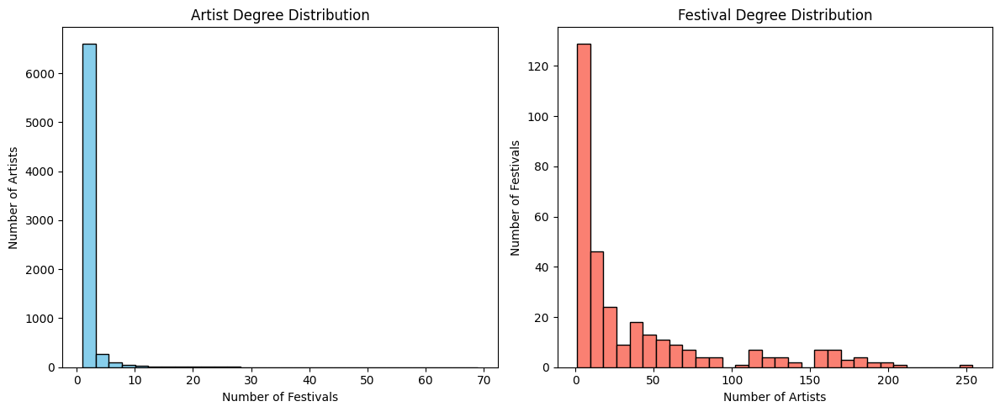

In [69]:
# plot degree distributions
plt.figure(figsize=(12, 5))
plt.subplot(1, 2, 1)
plt.hist(artist_degrees, bins=30, color='skyblue', edgecolor='black')
plt.title('Artist Degree Distribution')
plt.xlabel('Number of Festivals')
plt.ylabel('Number of Artists') 
plt.subplot(1, 2, 2)
plt.hist(festival_degrees, bins=30, color='salmon', edgecolor='black')
plt.title('Festival Degree Distribution')
plt.xlabel('Number of Artists')
plt.ylabel('Number of Festivals')
plt.tight_layout()
plt.show()

**Cross-partition degree correlation**

In [ ]:
#need to seperate the nodes to compare degrees per side
artist_deg = {n: G.degree(n) for n in artist_nodes}
festival_deg = {n: G.degree(n) for n in festival_nodes}

artist_side = []
festival_side = []

for artist in artist_nodes:
    for festival in G.neighbors(artist):
        artist_side.append(artist_deg[artist])
        festival_side.append(festival_deg[festival])


In [ ]:
corr, pval = pearsonr(artist_side, festival_side)
print("Cross-partition degree correlation:", corr)


Cross-partition degree correlation: -0.3429476074636882


**Normalized Genre**

In [36]:
from collections import Counter

genre_counter = Counter()

for node, data in G.nodes(data=True):
    if data.get("bipartite") == "artist" and "genres" in data:
        genres = data["genres"]

        # Make sure genres is always treated as a list
        if isinstance(genres, list):
            n = len(genres)
            if n > 0:
                weight = 1 / n
                for g in genres:
                    genre_counter[g] += weight
        else:
            # Single genre: weight is 1
            genre_counter[genres] += 1

print("\n===== MOST COMMON GENRES IN NETWORK (NORMALIZED) =====")
for genre, count in genre_counter.most_common(20):
    print(f"{genre}: {count:.3f}")



===== MOST COMMON GENRES IN NETWORK (NORMALIZED) =====
dansk pop: 773.233
dansktop: 500.500
dansk rap: 305.000
swedish pop: 85.083
christmas: 72.733
metal: 52.374
alternative rock: 51.946
children's music: 51.667
indie rock: 48.708
norwegian pop: 45.417
pop: 42.220
folk: 41.369
jazz: 40.967
rock: 40.611
death metal: 40.100
britpop: 40.019
art pop: 39.303
idm: 38.225
experimental: 37.388
blues rock: 37.092


**Connected components**

In [79]:
components = list(nx.connected_components(G))
print("Number of connected components:", len(components))

Number of connected components: 1


In [80]:
#print each connected component sizes
for i, component in enumerate(components):
    print(f"Component {i+1} size: {len(component)}")

Component 1 size: 7439


**Components that will be excluded**

In [81]:
# print what is included in components[i] where i goes from 2 to 8.
for i in range(1, len(components)):
    for node in components[i]:
        print(f"Component {i} includes node:{node}")

**Analysis of shortest path (from largest component)**

In [74]:
# copy of network and only save largest components
G_orginal = G.copy()
largest_component = max(components, key=len)
G = G_orginal.subgraph(largest_component).copy()

Average shortest path length: 4.522064751725796


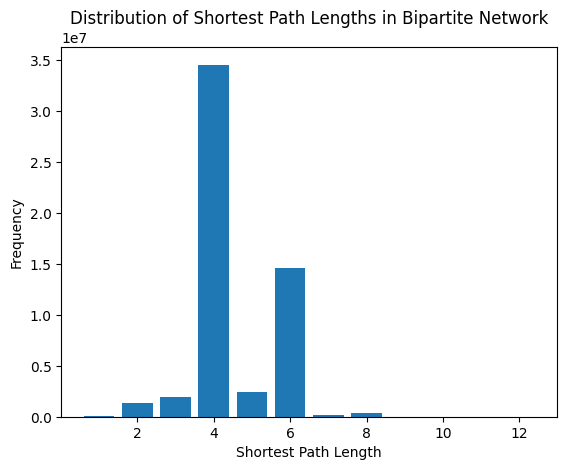

In [76]:
# Compute the averge shortest path
if nx.is_connected(G):
    avg_path = nx.average_shortest_path_length(G)
    print("Average shortest path length:", avg_path)
else:
    print("Graph is not connected; average shortest path length is undefined.")


# Only works if the graph is connected, just a "safety measure" if somebody forgot to run the component code above
if not nx.is_connected(G):
    print("Graph is not fully connected. Using largest connected component.")
    largest_component = max(nx.connected_components(G), key=len)
    G_sub = G.subgraph(largest_component)
else:
    G_sub = G

# Calculate all shortest path lengths
path_lengths = dict(nx.all_pairs_shortest_path_length(G_sub))

# Flatten the distances into a single list (excluding 0 self-distances)
all_lengths = []

for source in path_lengths:
    for target in path_lengths[source]:
        if source != target:
            all_lengths.append(path_lengths[source][target])

# Count occurrences of each path length
length_counts = Counter(all_lengths)

# ========================
# PLOT DISTRIBUTION
# ========================

plt.figure()
plt.bar(length_counts.keys(), length_counts.values())
plt.xlabel("Shortest Path Length")
plt.ylabel("Frequency")
plt.title("Distribution of Shortest Path Lengths in Bipartite Network")
plt.show()

In [ ]:
# to be able to look at shortest path for deep dept analysis, the following is constructed to get all shortest path between every two festivals
# this focus is ooooonly on shortest path between any festival. (not projectiled, as we are using artist as "stepping stones" to reach other festivals)

def analyze_shortest_paths(G):
    # Identify festivals

    rows = []
    for f1 in festival_nodes:
        for f2 in festival_nodes:
            if f1 != f2:
                try:
                    d = nx.shortest_path_length(G, f1, f2)
                    year=G.nodes[f1].get("year")
                    type=G.nodes[f1].get("festival")
                    rows.append((f1, f2, d,year,type))
                except nx.NetworkXNoPath:
                    pass

    df_dist = pd.DataFrame(rows, columns=["festival1", "festival2", "distance","year","festival_name"])

    print("\nGENERAL SHORTEST PATH STATS")
    print(df_dist["distance"].describe())
    print("Mean shortest path:", df_dist["distance"].mean())

    # Histogram
    plt.figure(figsize=(8,5))
    plt.hist(df_dist["distance"], bins=range(df_dist["distance"].max()+1))
    plt.xlabel("Bipartite shortest path length")
    plt.ylabel("Count")
    plt.title("Distribution of Festival–Festival Bipartite Shortest Paths")
    plt.show()

    return df_dist



GENERAL SHORTEST PATH STATS
count    98910.000000
mean         3.496957
std          1.155803
min          2.000000
25%          2.000000
50%          4.000000
75%          4.000000
max         10.000000
Name: distance, dtype: float64
Mean shortest path: 3.4969568294409057


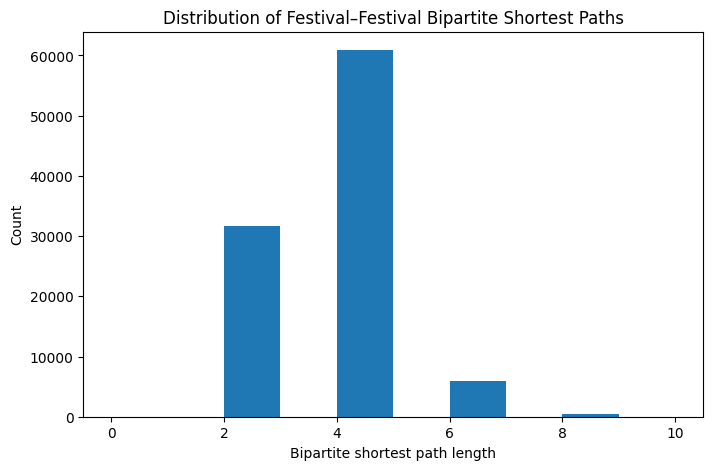

In [ ]:
df = analyze_shortest_paths(G)

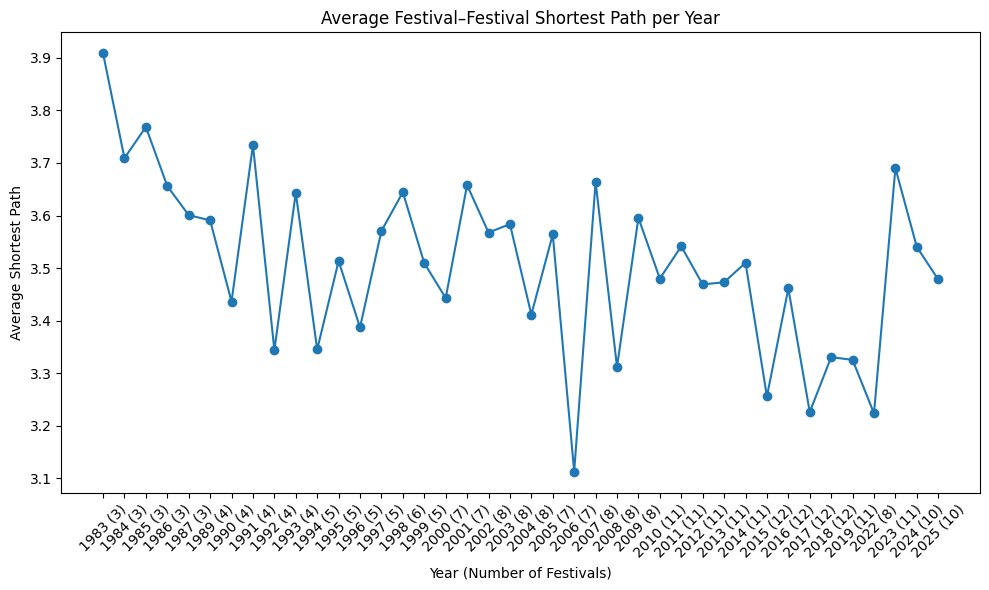

In [ ]:
# Group by year: average shortest path and festival count
year_stats = (
    df
    .groupby("year")
    .agg(
        avg_shortest_path=("distance", "mean"),
        festival_count=("festival1", "nunique")
    )
    .reset_index()
)

# Keep only years with more than 2 festivals (not interested in years where only roskilde festival was active)
year_stats = year_stats[year_stats["festival_count"] > 2]

# Create readable label
year_stats["year_label"] = (
    year_stats["year"].astype(str)
    + " (" + year_stats["festival_count"].astype(str) + ")"
)

# Plot
plt.figure(figsize=(10,6))
plt.plot(year_stats["year_label"], year_stats["avg_shortest_path"], marker="o")
plt.xticks(rotation=45)
plt.xlabel("Year (Number of Festivals)")
plt.ylabel("Average Shortest Path")
plt.title("Average Festival–Festival Shortest Path per Year")
plt.tight_layout()
plt.show()


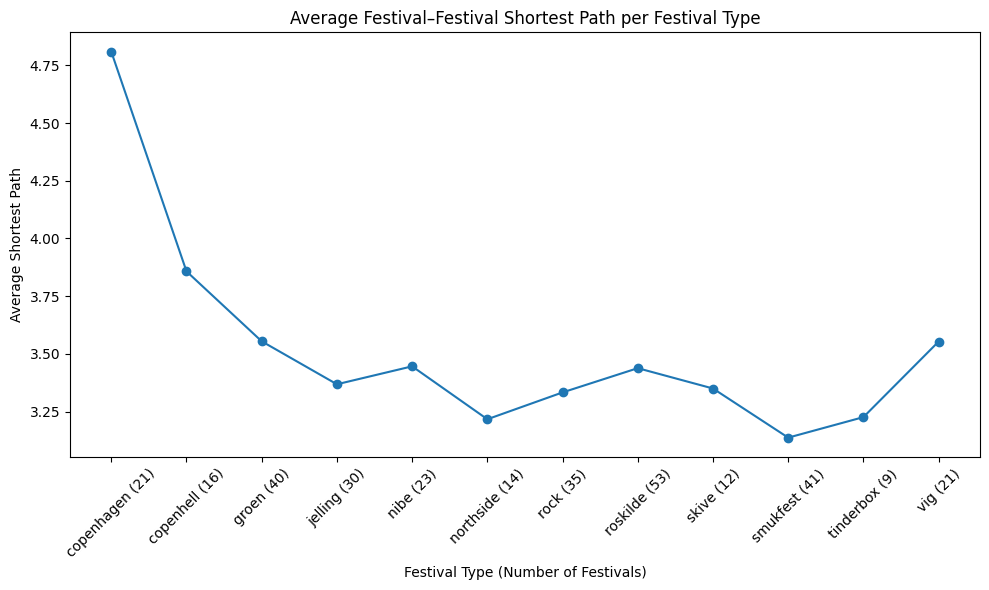

In [129]:
# Group by festival type: average shortest path and festival count
type_stats = (
    df
    .groupby("festival_name")   # this is your type column, yes very confusing naming
    .agg(
        avg_shortest_path=("distance", "mean"),
        festival_count=("festival1", "nunique")
    )
    .reset_index()
)

# Keep only types with more than 2 festivals
type_stats = type_stats[type_stats["festival_count"] > 2]

# Create readable label
type_stats["type_label"] = (
    type_stats["festival_name"].astype(str)
    + " (" + type_stats["festival_count"].astype(str) + ")"
)

# Plot
plt.figure(figsize=(10,6))
plt.plot(type_stats["type_label"], type_stats["avg_shortest_path"], marker="o")
plt.xticks(rotation=45)
plt.xlabel("Festival Type (Number of Festivals)")
plt.ylabel("Average Shortest Path")
plt.title("Average Festival–Festival Shortest Path per Festival Type")
plt.tight_layout()
plt.show()


**Diameter**

Longest shortest path is 12 steps. Pick the two nodes in your graph that are the farthest apart in terms of graph distance (shortest path length). Between them, the shortest route takes 12 edges

In [130]:
#Network Diameter
diameter = nx.diameter(G)
print("Network Diameter:", diameter)

Network Diameter: 12


**Clustering Coefficient (didnt comment directly on this in report)**

In [ ]:
from networkx.algorithms import bipartite

clustering_bip = bipartite.clustering(G)
avg_clust_bip = bipartite.average_clustering(G)
print("Average bipartite clustering:", avg_clust_bip)


Average bipartite clustering: 0.577816019264327


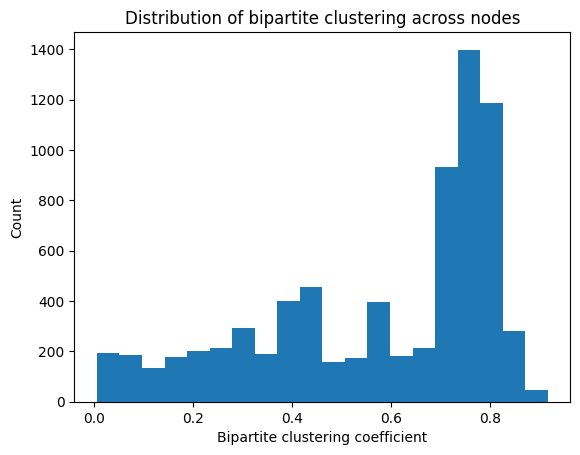

In [ ]:
import matplotlib.pyplot as plt

vals = list(clustering_bip.values())

plt.hist(vals, bins=20)
plt.xlabel("Bipartite clustering coefficient")
plt.ylabel("Count")
plt.title("Distribution of bipartite clustering across nodes")
plt.show()


In [ ]:
def analyze_clustering(G):
    # Compute bipartite clustering for all nodes
    clustering = nx.algorithms.bipartite.clustering(G)

    rows = []

    # For each festival, compute average clustering across its artist-neighbors
    for f in festival_nodes:
        neighbors = list(G.neighbors(f))
        if len(neighbors) == 0:
            continue

        artist_cluster_values = [clustering[a] for a in neighbors]

        avg_clust = sum(artist_cluster_values) / len(artist_cluster_values)
        year = G.nodes[f].get("year")
        fest_type = G.nodes[f].get("festival")

        rows.append((f, year, fest_type, avg_clust, len(neighbors)))

    df_clust = pd.DataFrame(
        rows,
        columns=["festival_name", "year", "festival_type", "avg_clustering", "artist_count"]
    )

    print("\nGENERAL FESTIVAL CLUSTERING STATS")
    print(df_clust["avg_clustering"].describe())
    print("Mean avg clustering:", df_clust["avg_clustering"].mean())

    # Histogram of average clustering
    plt.figure(figsize=(8, 5))
    plt.hist(df_clust["avg_clustering"], bins=20)
    plt.xlabel("Average Bipartite Clustering per Festival")
    plt.ylabel("Count")
    plt.title("Distribution of Average Artist Clustering Across Festivals")
    plt.tight_layout()
    plt.show()

    return df_clust

def build_artist_clustering_df(G):
    clustering = nx.algorithms.bipartite.clustering(G)

    rows = []

    for node in G.nodes():
        if G.nodes[node].get("bipartite") == "artist":
            pop = G.nodes[node].get("popularity")
            genres = G.nodes[node].get("genres", [])
            rows.append((
                node,
                clustering[node],
                pop,
                genres
            ))

    df_art = pd.DataFrame(
        rows,
        columns=["artist_name", "clustering", "popularity", "genres"]
    )
    print("\nGENERAL ARTIST CLUSTERING STATS")
    print(df_art["clustering"].describe())
    print("Mean clustering:", df_art["clustering"].mean())

    # Distribution of artist clustering
    plt.figure(figsize=(8, 5))
    plt.hist(df_art["clustering"], bins=20)
    plt.xlabel("Bipartite Clustering (Artists)")
    plt.ylabel("Count")
    plt.title("Distribution of Artist Bipartite Clustering")
    plt.tight_layout()
    plt.show()


    return df_art




GENERAL FESTIVAL CLUSTERING STATS
count    306.000000
mean       0.260688
std        0.203223
min        0.017829
25%        0.086913
50%        0.187600
75%        0.411895
max        0.848457
Name: avg_clustering, dtype: float64
Mean avg clustering: 0.26068750587442874


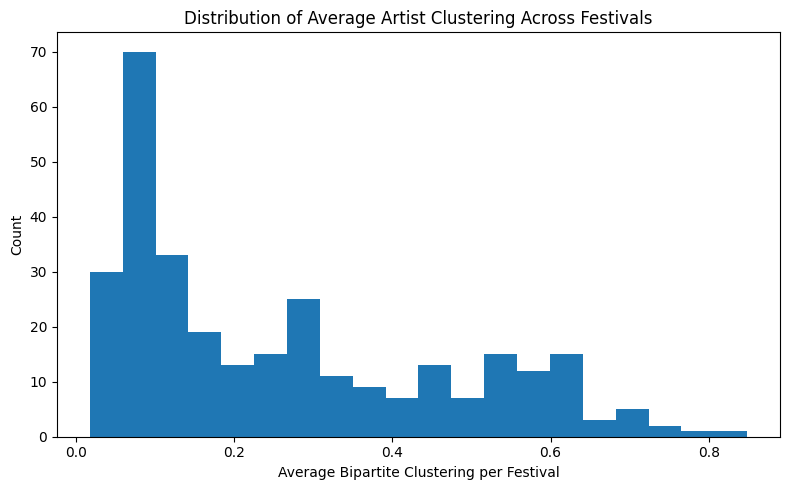

In [ ]:
df_clust = analyze_clustering(G)

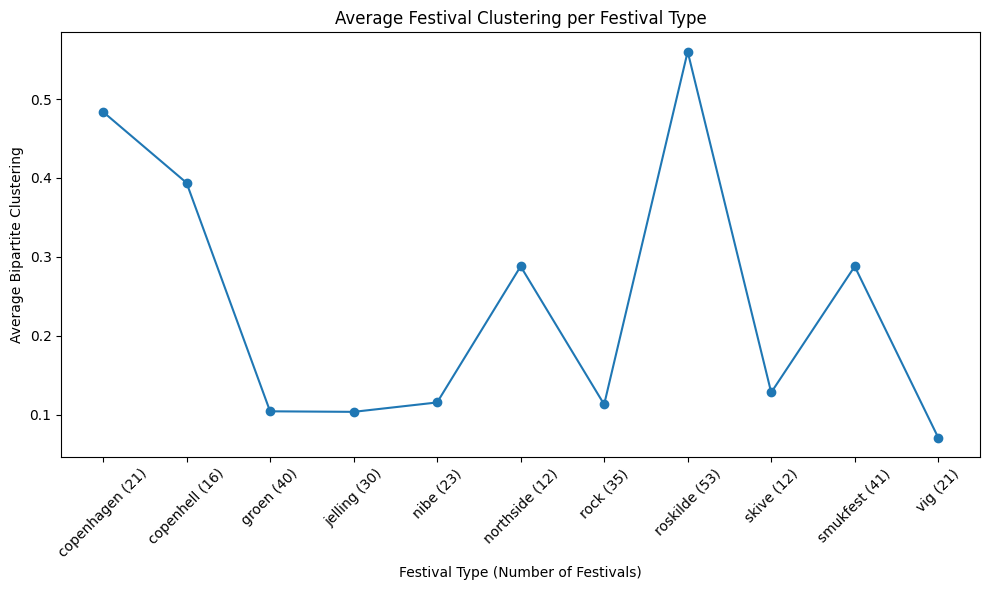

In [ ]:
type_stats = (
    df_clust
    .groupby("festival_type")
    .agg(
        avg_clustering=("avg_clustering", "mean"),
        festival_count=("festival_name", "nunique")
    )
    .reset_index()
)

# Filter types that appear more than twice (same as shortest path)
type_stats = type_stats[type_stats["festival_count"] > 2]

# Create label
type_stats["type_label"] = (
    type_stats["festival_type"].astype(str)
    + " (" + type_stats["festival_count"].astype(str) + ")"
)

# Plot
plt.figure(figsize=(10,6))
plt.plot(type_stats["type_label"], type_stats["avg_clustering"], marker="o")
plt.xticks(rotation=45)
plt.xlabel("Festival Type (Number of Festivals)")
plt.ylabel("Average Bipartite Clustering")
plt.title("Average Festival Clustering per Festival Type")
plt.tight_layout()
plt.show()


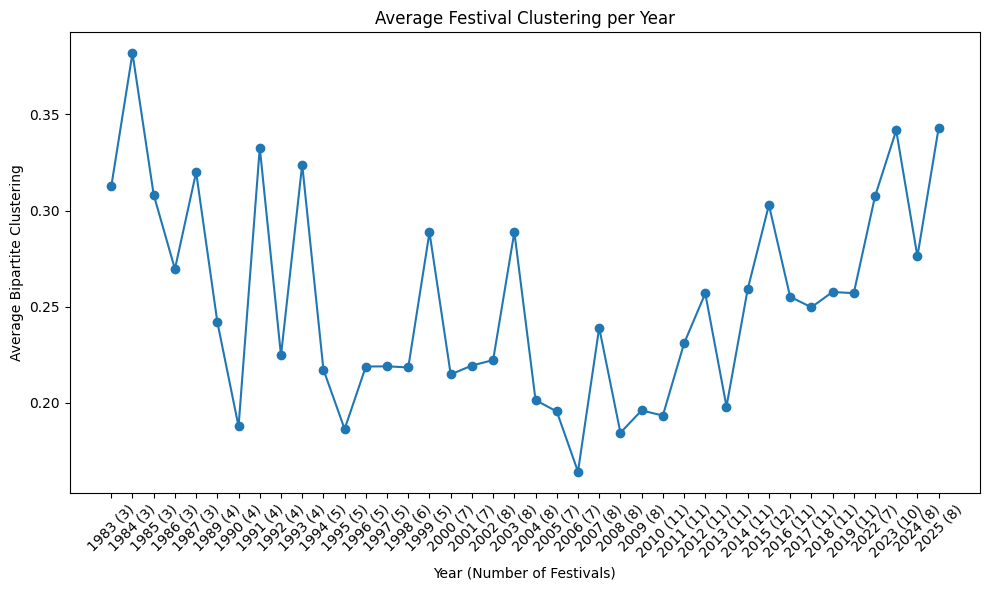

In [ ]:
# Group by year: average clustering and number of festivals
year_stats = (
    df_clust
    .groupby("year")
    .agg(
        avg_clustering=("avg_clustering", "mean"),
        festival_count=("festival_name", "nunique")
    )
    .reset_index()
)

# Keep only years with more than 2 festivals
year_stats = year_stats[year_stats["festival_count"] > 2]

# Create readable label
year_stats["year_label"] = (
    year_stats["year"].astype(str)
    + " (" + year_stats["festival_count"].astype(str) + ")"
)

# Plot
plt.figure(figsize=(10,6))
plt.plot(year_stats["year_label"], year_stats["avg_clustering"], marker="o")
plt.xticks(rotation=45)
plt.xlabel("Year (Number of Festivals)")
plt.ylabel("Average Bipartite Clustering")
plt.title("Average Festival Clustering per Year")
plt.tight_layout()
plt.show()




GENERAL ARTIST CLUSTERING STATS
count    7100.000000
mean        0.600513
std         0.215934
min         0.014493
25%         0.418560
50%         0.720142
75%         0.773324
max         0.916667
Name: clustering, dtype: float64
Mean clustering: 0.6005127926526604


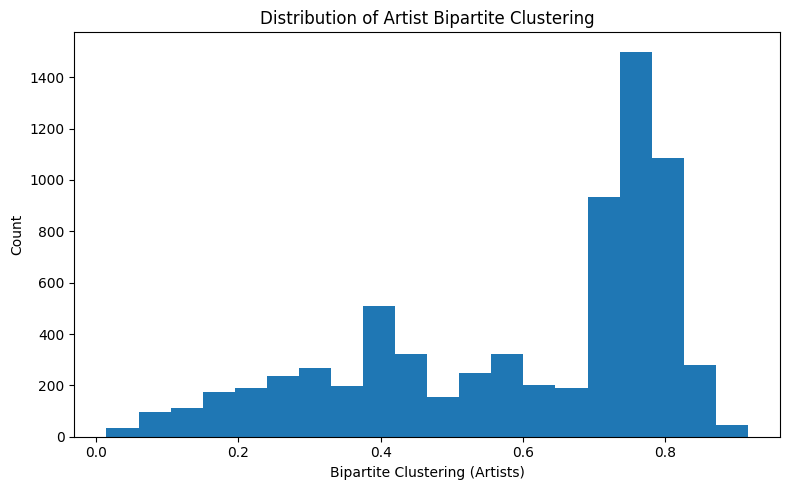

,artist_name,clustering,popularity,genres
0,surprise,0.628683,47.0,"[jazz funk, indie jazz, jazz house]"
1,tom-bailey,0.628683,50.0,[tropical house]
2,gasolin,0.290419,48.0,"[dansktop, dansk pop]"
3,vannis-aften,0.446157,64.0,"[dansk rap, dansktop, dansk pop]"
4,sunny-side-stompers,0.628683,45.0,"[christmas, dansk pop]"
...,...,...,...,...
7095,s!vas,0.292094,4.0,[]
7096,bro,0.292094,39.0,"[dansk pop, dansk rap]"
7097,jeppe-loftager,0.292094,18.0,"[dansk pop, dansk rap]"
7098,josefine-winding,0.214841,51.0,"[dansk pop, dansktop, children's music]"


In [ ]:
df_art = build_artist_clustering_df(G)

**Entropy based on genre**

In [87]:
# year_genre_score[year][genre] accumulates total weighted contributions
# of genres based on artists performing at festivals that year.
year_genre_score = defaultdict(lambda: defaultdict(float))

for fest in festival_nodes:
    # extract the festival year
    year = int(G.nodes[fest]["year"])
    
    # get all artists connected to this festival
    artists = G.neighbors(fest)

    for artist in artists:
        # skip nodes that aren't artists
        if artist not in artist_nodes:
            continue

        # fetch the artist's genre list
        genres = G.nodes[artist].get("genres", [])
        if not genres:
            continue

        # each artist contributes weight split evenly across their genres
        weight_per_genre = 1.0 / len(genres)

        # add weighted contribution to each genre for this festival's year
        for g in genres:
            year_genre_score[year][g] += weight_per_genre

# normalize genre weights within each year so they form a probability distribution
year_genre_norm = {}

for year, genre_dict in year_genre_score.items():
    total = sum(genre_dict.values())
    year_genre_norm[year] = {
        g: c / total for g, c in genre_dict.items()
    }

# compute entropy of the genre distribution per year
# higher entropy = more diversity in genres that year
year_entropy = {}

for year, genre_dist in year_genre_norm.items():
    H = 0.0
    for p in genre_dist.values():
        if p > 0:
            H -= p * math.log(p)
    year_entropy[year] = H


In [88]:
festival_genre_score = {}  # stores {festival_node: {genre: raw_score}}

for fest in festival_nodes:
    # accumulate genre weights for this specific festival
    genre_weights = defaultdict(float)

    # get artist nodes connected to this festival
    artists = G.neighbors(fest)

    for artist in artists:
        # skip if the node isn't recognized as an artist
        if artist not in artist_nodes:
            continue

        # list of genres for this artist
        genres = G.nodes[artist].get("genres", [])
        if not genres:
            continue  # skip artists with no genre metadata

        # split artist's weight evenly across their genres
        weight_per_genre = 1.0 / len(genres)

        # add the contribution to each genre
        for g in genres:
            genre_weights[g] += weight_per_genre

    # store completed genre-weight dictionary for the festival
    festival_genre_score[fest] = dict(genre_weights)


# normalize genre weights within each festival
festival_genre_norm = {}

for fest, weights in festival_genre_score.items():
    total = sum(weights.values())

    # handle festivals that somehow end up with no genre contributions
    if total == 0:
        festival_genre_norm[fest] = {}
        continue
    
    # convert weights into a probability distribution
    festival_genre_norm[fest] = {g: w / total for g, w in weights.items()}


# compute entropy of each normalized genre distribution
festival_entropy = {}

for fest, genre_dist in festival_genre_norm.items():
    H = 0.0
    for p in genre_dist.values():
        if p > 0:
            H -= p * math.log(p)
    festival_entropy[fest] = H


# group entropy values by (festival_name -> list of (year, entropy))
festival_entropy_over_time = defaultdict(list)

for fest in festival_nodes:
    name = G.nodes[fest]["festival"]  # festival's name label
    year = G.nodes[fest]["year"]      # festival's year
    H = festival_entropy[fest]        # entropy for this festival instance

    # append tuple (year, entropy) to the correct festival name
    festival_entropy_over_time[name].append((year, H))


# ensure entropy-over-time lists are sorted chronologically
for name in festival_entropy_over_time:
    festival_entropy_over_time[name].sort(key=lambda x: x[0])


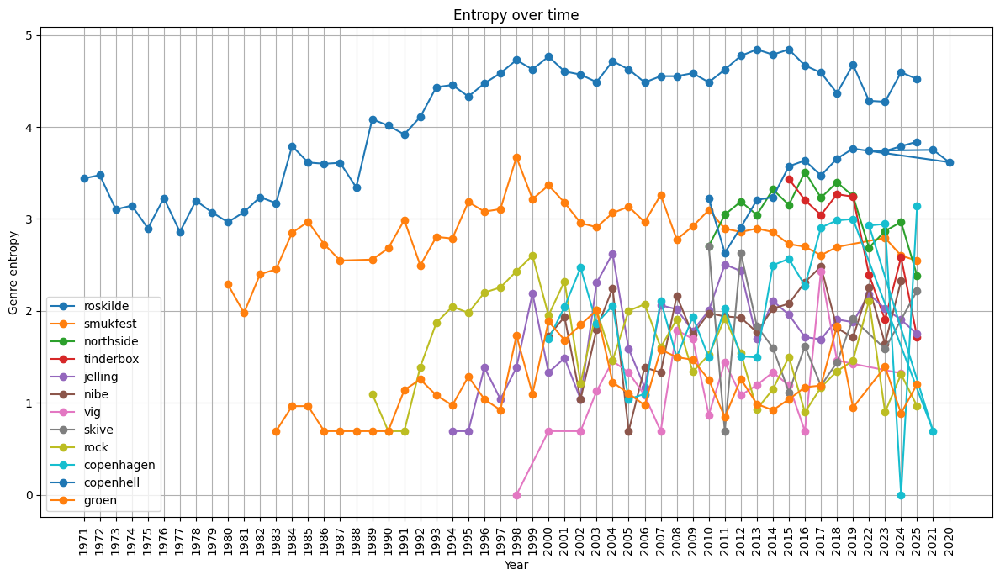

In [89]:
#plot all entropy over time for all festivals in one plot (just to get a general overview)
import matplotlib.pyplot as plt

plt.figure(figsize=(12, 7))

for name, entries in festival_entropy_over_time.items():
    years = [y for y, _ in entries]
    ent   = [h for _, h in entries]

    plt.plot(years, ent, marker='o', label=name)

plt.title("Entropy over time")
plt.xlabel("Year")
plt.ylabel("Genre entropy")
plt.grid(True)

plt.xticks(rotation=90)
plt.legend()
plt.tight_layout()

plt.show()


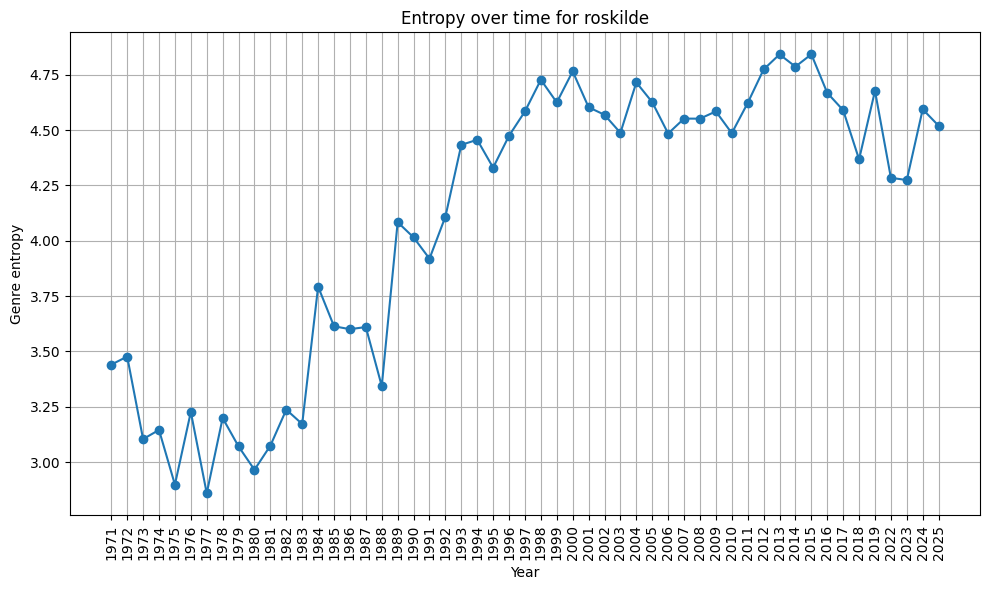

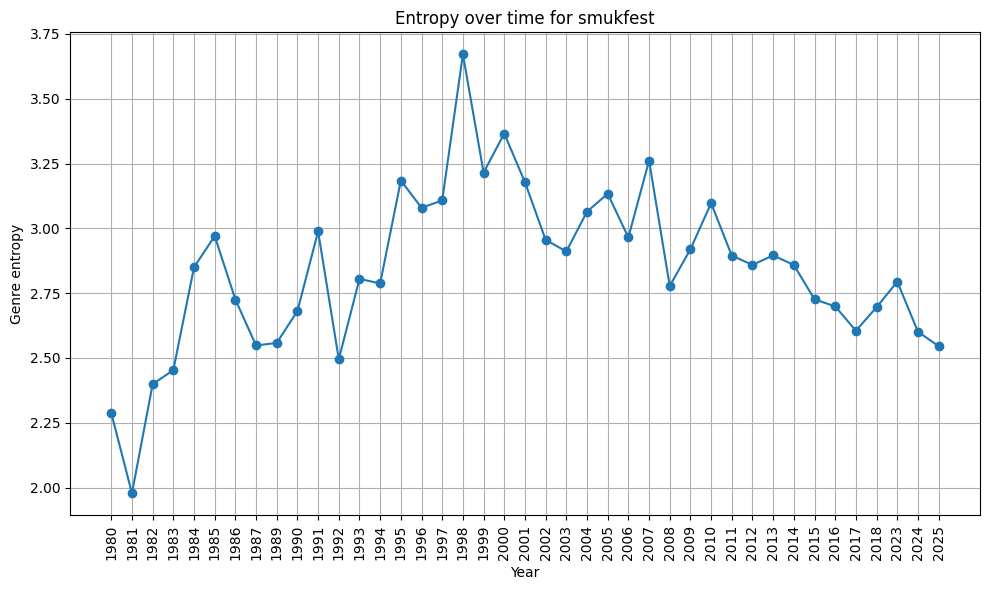

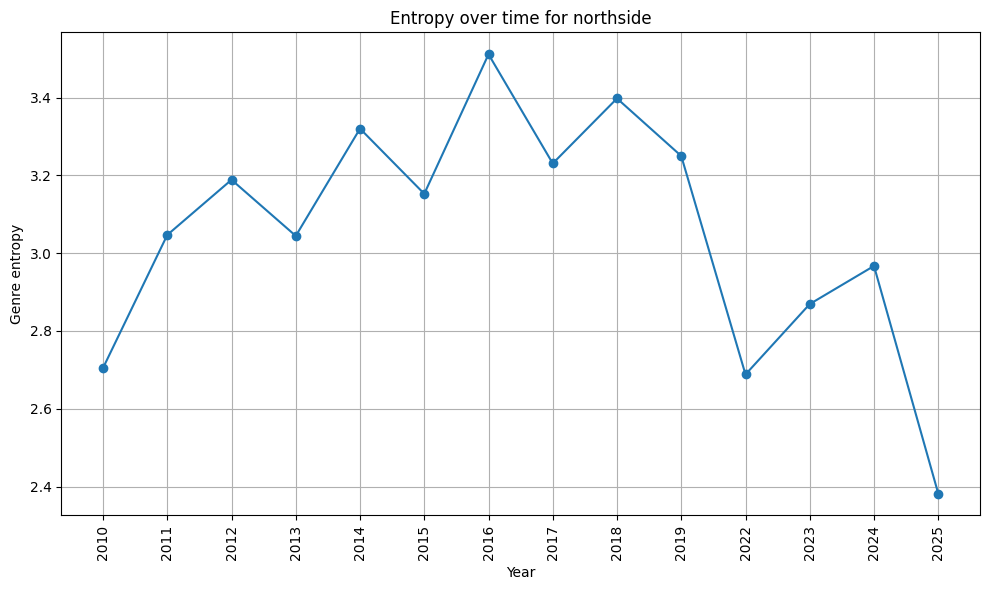

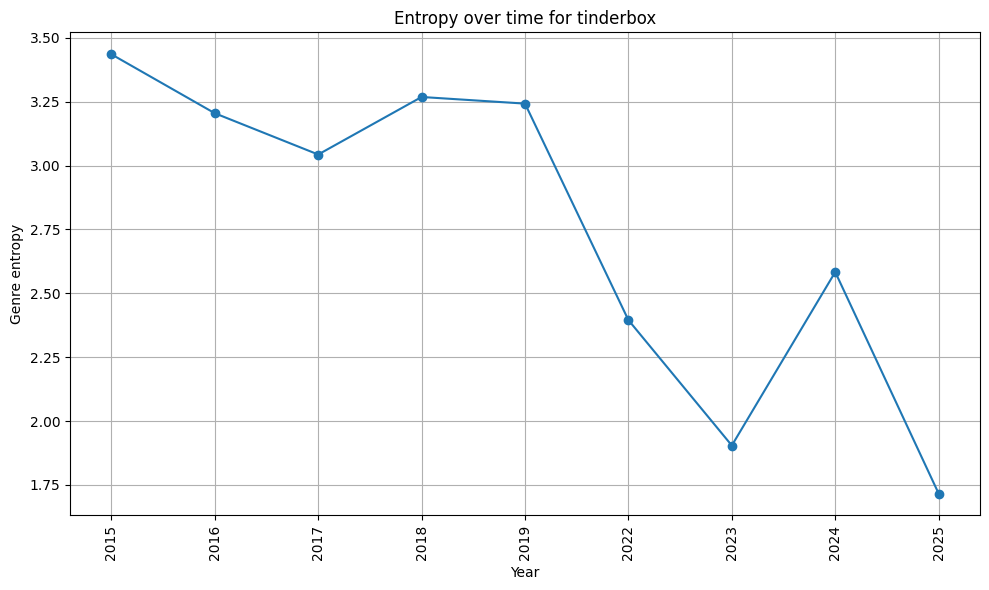

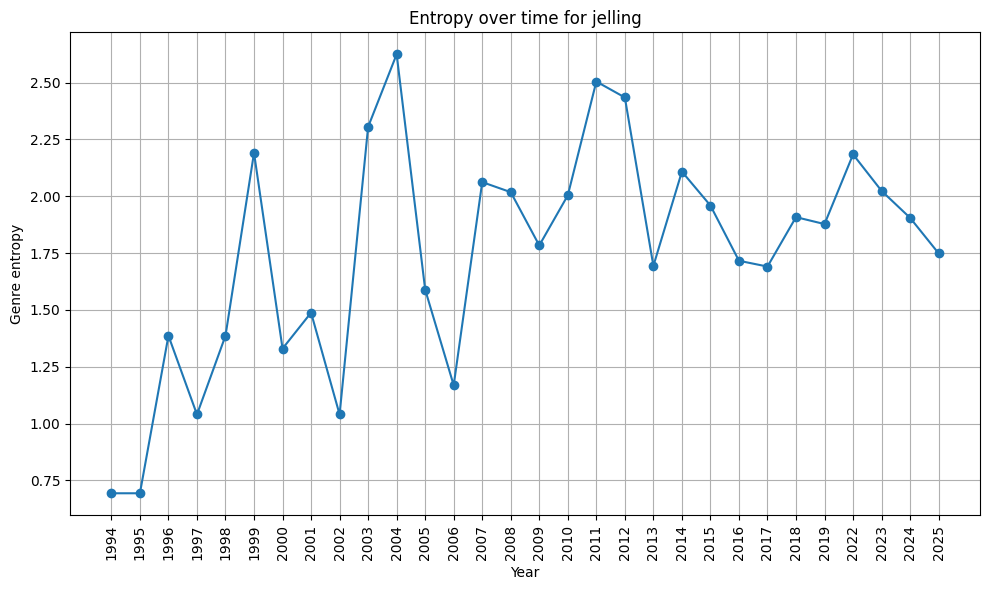

...

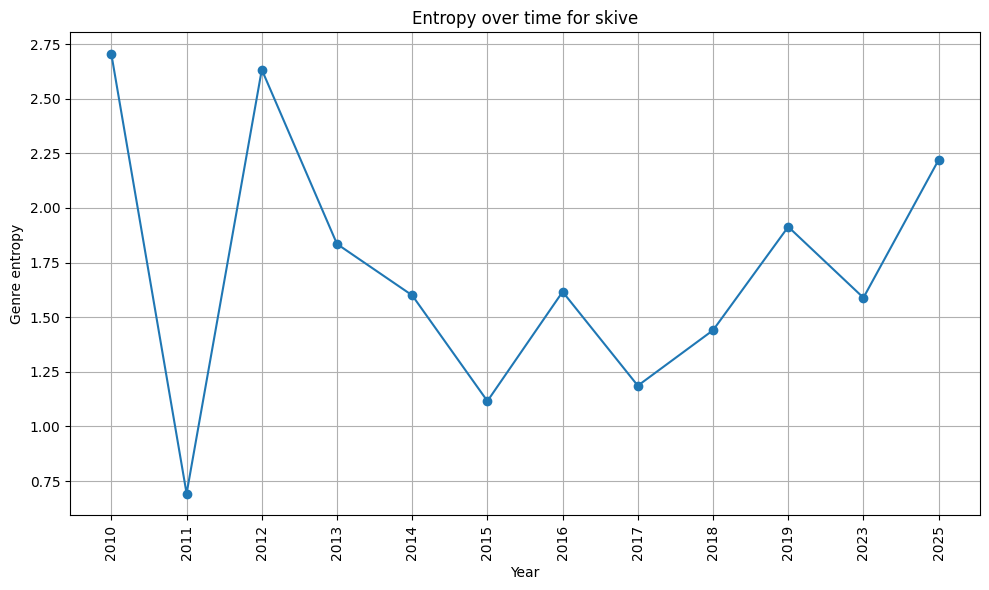

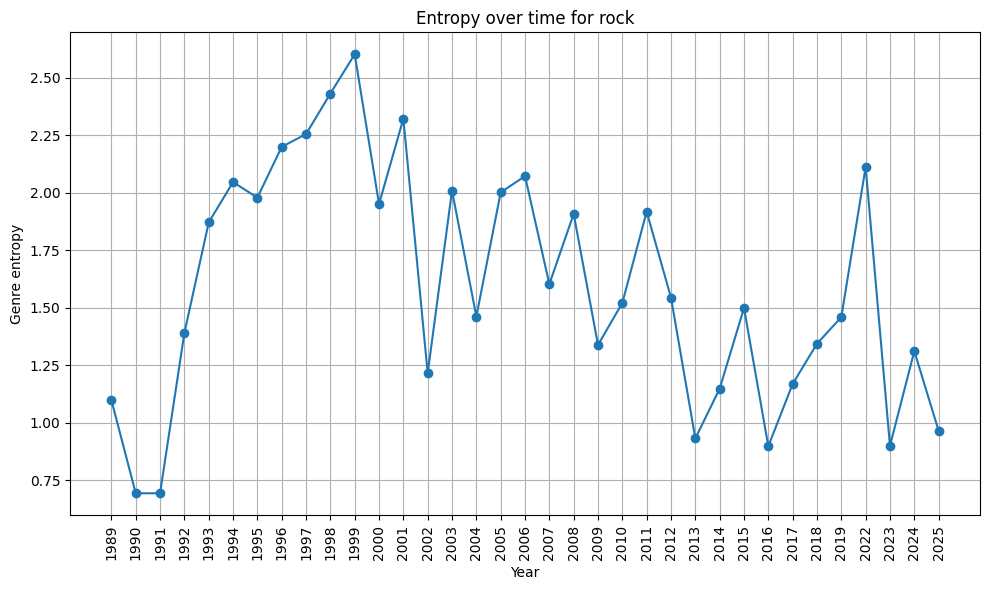

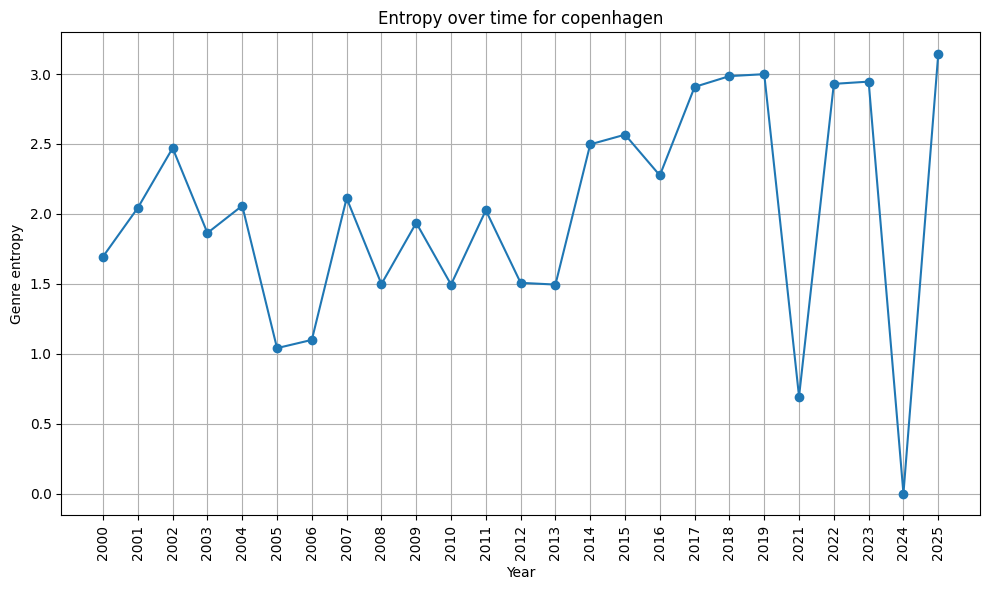

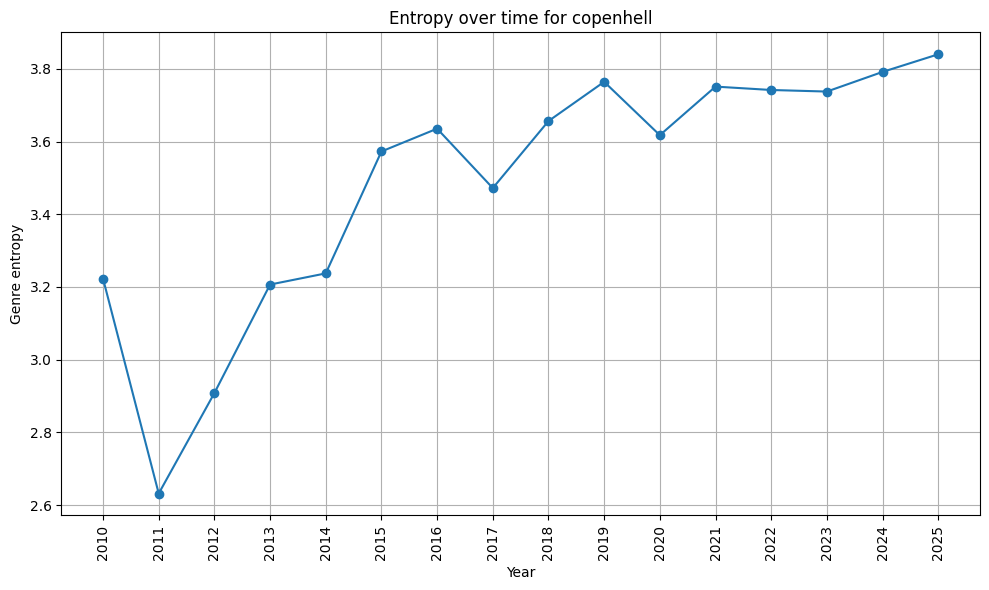

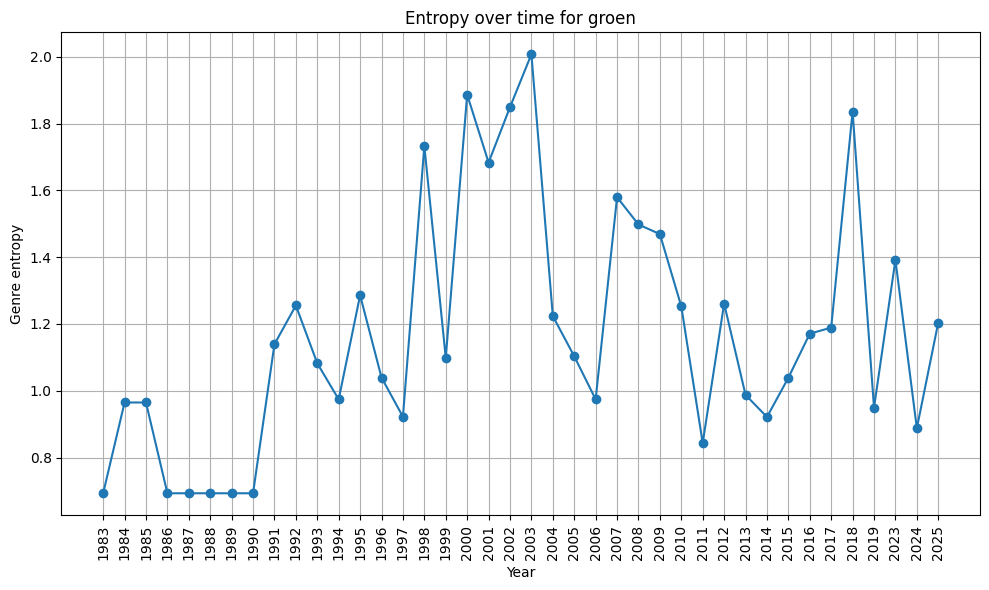

In [90]:
#plot every single entropy plot, as the general plot is hard to read
import matplotlib.pyplot as plt

for name, entries in festival_entropy_over_time.items():
    years = [y for y, _ in entries]
    ent   = [h for _, h in entries]

    plt.figure(figsize=(10,6))  # wider figure so labels don't overlap

    plt.plot(years, ent, marker='o')
    plt.title(f"Entropy over time for {name}")
    plt.xlabel("Year")
    plt.ylabel("Genre entropy")
    plt.grid(True)

    plt.xticks(years, rotation=90)  # make years vertical and readable
    plt.tight_layout()             # adjust margins so labels fit

    plt.show()
# ========================

**Correlation for entropy**

In [91]:
#calculate correlation between the general ecosystem entropy and the entropy for each festival. This is done to see of they group together.
import numpy as np

festival_correlations = {}

# overall entropy as a dict
overall = year_entropy   # {year: entropy}

for fest_name, entries in festival_entropy_over_time.items():
    # turn festival entries into a dict {year: entropy}
    fest_dict = {int(y): H for y, H in entries}

    # find common years to compare
    common_years = sorted(set(overall.keys()) & set(fest_dict.keys()))
    if len(common_years) < 2:
        # skip useless cases with no overlap
        continue

    overall_vals = np.array([overall[y] for y in common_years])
    fest_vals    = np.array([fest_dict[y] for y in common_years])

    # correlation
    corr = np.corrcoef(overall_vals, fest_vals)[0, 1]
    festival_correlations[fest_name] = corr

festival_correlations


{'roskilde': 0.9536426509695781,
 'smukfest': 0.8057922591939306,
 'northside': 0.4478018814745199,
 'tinderbox': 0.36725107325388656,
 'jelling': -0.21207086311736975,
 'nibe': -0.06825474058172719,
 'vig': -0.5322270012302918,
 'skive': 0.019410774442054066,
 'rock': 0.6822032486493698,
 'copenhagen': 0.06652249046513309,
 'copenhell': -0.13071846834335443,
 'groen': 0.5110775361406329}

**Plot entropy for article**

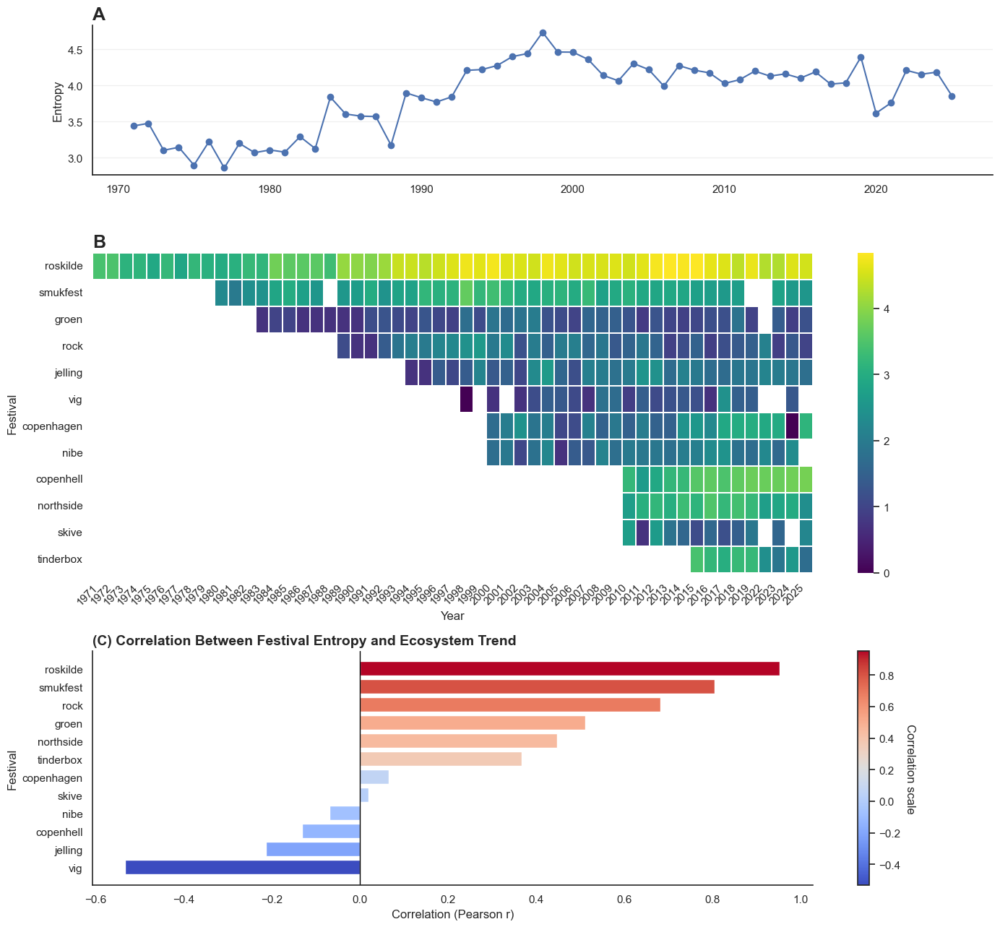

In [ ]:
# plot for report (got scrapped as it size was a bit to big)

# Panel A data
years_all = sorted(year_entropy.keys())
entropy_all = [year_entropy[y] for y in years_all]

# Panel B data (festival-year entropy)
rows = []
for fest, entries in festival_entropy_over_time.items():
    for year, entropy in entries:
        year = int(year)
        if year in (2020, 2021):
            continue
        rows.append({"Festival": fest, "Year": year, "Entropy": entropy})

df_fest = pd.DataFrame(rows)

heat_matrix_fest = df_fest.pivot(index="Festival", columns="Year", values="Entropy")

# sort festivals by first appearance
festival_order = (
    df_fest.groupby("Festival")["Year"]
    .min()
    .sort_values()
    .index.tolist()
)
heat_matrix_fest = heat_matrix_fest.loc[festival_order]

vmin = df_fest["Entropy"].min()
vmax = df_fest["Entropy"].max()

# Panel C data (correlation)
festivals_corr = list(festival_correlations.keys())
corr_values = [festival_correlations[f] for f in festivals_corr]

order = np.argsort(corr_values)
festivals_corr = [festivals_corr[i] for i in order]
corr_values = [corr_values[i] for i in order]

# -----------------------------
# FIGURE
# -----------------------------
fig, (ax1, ax2, ax3) = plt.subplots(
    3, 1, figsize=(14, 13),
    gridspec_kw={"height_ratios": [1.4, 3, 2.2]}
)

# -----------------------------
# PANEL A (line plot)
# -----------------------------
ax1.plot(years_all, entropy_all, marker="o", linewidth=1.5)
ax1.set_title("A", loc="left", fontsize=18, fontweight="bold")
ax1.set_ylabel("Entropy")
ax1.grid(True, axis="y", alpha=0.3)
ax1.set_xlabel("")

# -----------------------------
# PANEL B (heatmap)
# -----------------------------
sns.heatmap(
    heat_matrix_fest,
    cmap="viridis",
    vmin=vmin, vmax=vmax,
    linewidths=0.3,
    cbar=True,
    ax=ax2
)
ax2.set_title("B", loc="left", fontsize=18, fontweight="bold")
ax2.set_xlabel("Year")
ax2.set_ylabel("Festival")
ax2.set_xticklabels(ax2.get_xticklabels(), rotation=45, ha="right")

# -----------------------------
# PANEL C (bar plot)
# -----------------------------
# --- prepare correlation data ---
festival_corr_sorted = dict(sorted(festival_correlations.items(), key=lambda x: x[1]))
festivals_corr = list(festival_corr_sorted.keys())
corr_values = list(festival_corr_sorted.values())

# --- colormap scaling ---
norm = plt.Normalize(min(corr_values), max(corr_values))
colors = plt.cm.coolwarm(norm(corr_values))

# --- plot ---
ax = plt.gca()

bars = ax.barh(festivals_corr, corr_values, color=colors)
ax.axvline(0, color="black", linewidth=1)

ax.set_title("(C) Correlation Between Festival Entropy and Ecosystem Trend",
             loc="left", fontsize=14, fontweight="bold")
ax.set_xlabel("Correlation (Pearson r)")
ax.set_ylabel("Festival")

# frame around plot
for spine in ax.spines.values():
    spine.set_visible(True)
    spine.set_linewidth(1.2)

# --- attach colorbar directly to this axes ---
sm = plt.cm.ScalarMappable(cmap="coolwarm", norm=norm)
sm.set_array(corr_values)
cbar = plt.colorbar(sm, ax=ax)   # ← FIX
cbar.set_label("Correlation scale", rotation=270, labelpad=15)


# -----------------------------
# UNIFY STYLE (remove top/right spines)
# -----------------------------
for ax in (ax1, ax2, ax3):
    ax.spines["top"].set_visible(False)
    ax.spines["right"].set_visible(False)

plt.tight_layout()
plt.show()


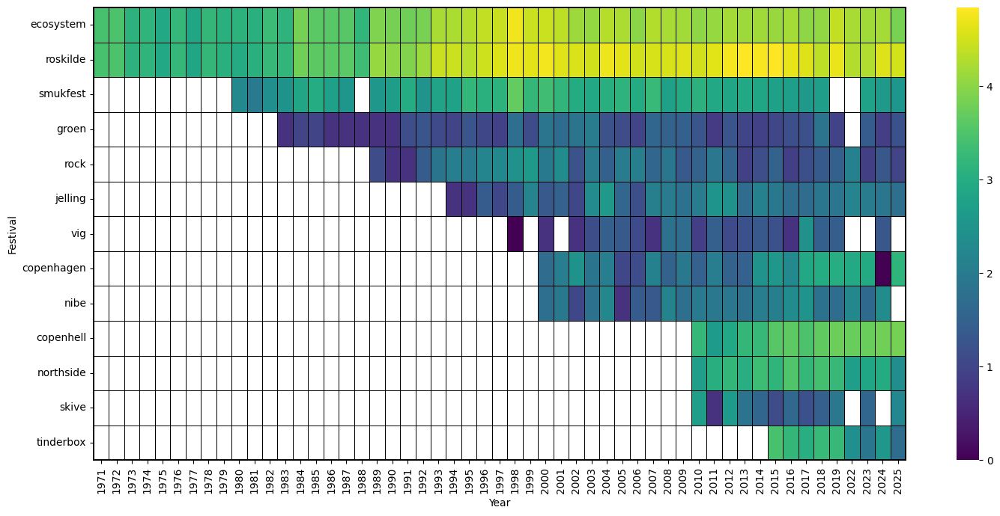

In [ ]:

# A: Ecosystem row
years_all = sorted(year_entropy.keys())
entropy_all = np.array([year_entropy[y] for y in years_all]).reshape(1, -1)
dfA = pd.DataFrame(entropy_all, index=["ecosystem"], columns=years_all)
valid_years = [y for y in years_all if y not in (2020, 2021)]

dfA_no_covid = dfA[valid_years]

# B: Festival-year matrix
rows = []
for fest, entries in festival_entropy_over_time.items():
    for year, entropy in entries:
        rows.append({"Festival": fest, "Year": int(year), "Entropy": entropy})

dfB = pd.DataFrame(rows)
dfB = dfB[~dfB["Year"].isin([2020, 2021])]

dfB_no_covid = dfB[~dfB["Year"].isin([2020, 2021])]


# ============================================================
# SINGLE FIGURE (A + B)
# ============================================================
# Compute festival order
festival_order = (
    dfB_no_covid.groupby("Festival")["Year"]
       .min()
       .sort_values()
       .index
       .tolist()
)

# Reorder festival heatmap
heat_matrixB = heat_matrixB.loc[festival_order]

# Combine ecosystem + festivals
combined = pd.concat([dfA_no_covid, heat_matrixB], axis=0)

# Ensure columns (years) are sorted
combined = combined.loc[:, sorted(combined.columns)]

plt.figure(figsize=(15, 7))
ax = sns.heatmap(
    combined,
    cmap="viridis",
    cbar=True,
    linewidths=0.4,
    linecolor="black"
)

ax.set_ylabel("Festival")
ax.set_xlabel("Year")

for spine in ax.spines.values():
    spine.set_visible(True)
    spine.set_linewidth(1.4)

plt.tight_layout()
plt.show()
